# 数据理解基础框架建设

在经典的CRISP-DM框架中，数据理解时连接需求理解和后续数据准备、模型建设等步骤的重要环节。在智能化应用中，数据时用户需求的具体表现。不进行完整的数据理解，就无法进行完成的需求理解。因此，数据理解在智能化应用开发过程中尤其重要。

为了减少同学们项目对接时数据理解步骤所做的重复性工作，我们准备撰写一个挖掘数据特性的分析函数库，对各类数据集进行标准化分析。


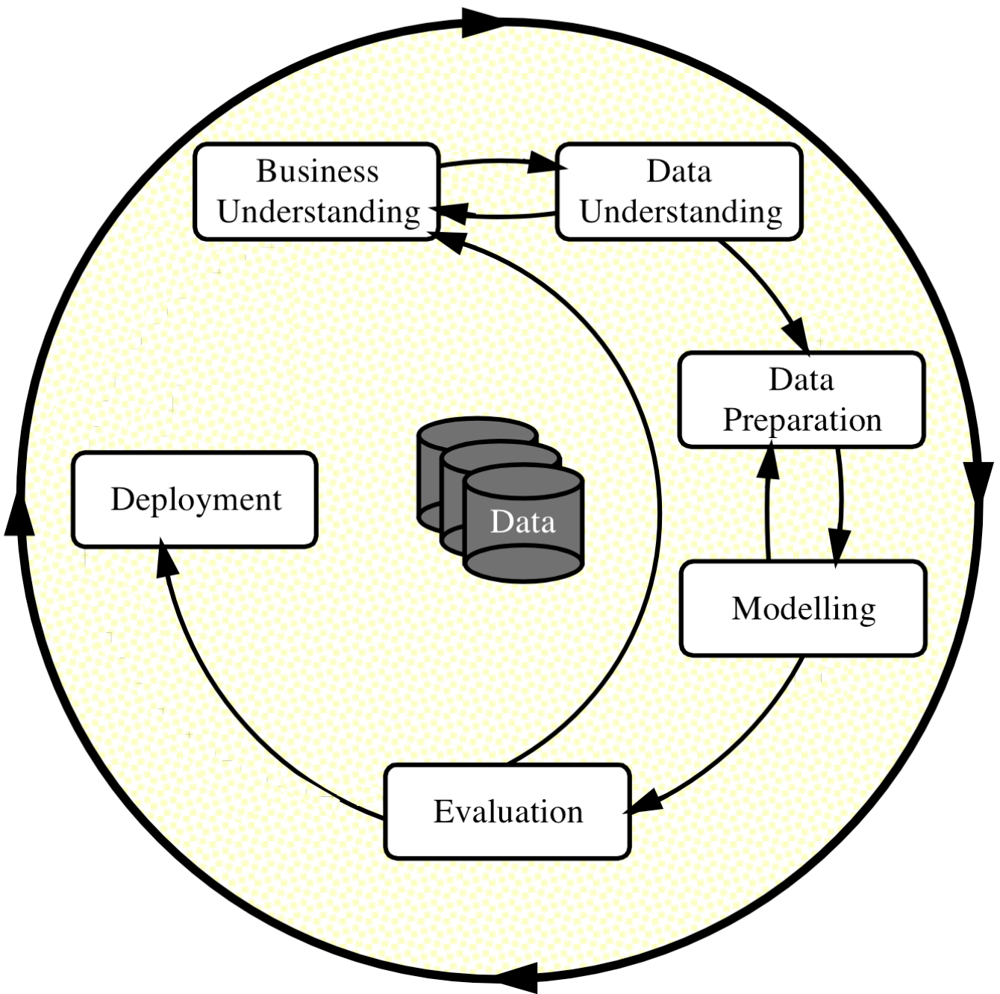

图：CRISP-DM（CRoss Industry Standard Process for Data Mining）主要步骤示意图


## 第零步：分析库导入与分析目标设置
为了更方便地进行数据处理与分析，我们定义了一个基类`DataframeAnalysis`,将输入数据统一处理成`pandas.DataFrame`格式.

目前支持的数据格式有：
- `csv`
- `xlsx`
- `parquet`

输入参数有：
- `root_path`: 所有数据存放的根路径
- `data_path`: 各个数据集在根路径下的子路径

In [22]:
import pandas as pd
import numpy as np
from Analysis.DataframeAnalysis import DataframeAnalysis
import plotly.express as px
import plotly.graph_objects as go
# 导入中冶赛迪高炉应用数据
root_path = 'data'
data_path = '异常炉况数据.csv'
DA = DataframeAnalysis(root_path,data_path)

DataAnalysis loading data from: data/异常炉况数据.csv


/Users/qiuyz24/PycharmProjects/Data-Process-Library/Analysis/DataframeAnalysis.py:23: DtypeWarning: Columns (27) have mixed types. Specify dtype option on import or set low_memory=False.
  df_raw = pd.read_csv(os.path.join(self.root_path, self.data_path),skiprows=skip)


## 第一步：缺失值与异常值管理
- 缺失值检测
- 缺失值填补
- 异常值检测
- 异常值剔除

In [23]:
# 获得所有列名
DA.df_raw.columns

Index(['time', 'feature1', 'feature2', 'feature3', 'feature4', 'feature5',
       'feature6', 'feature7', 'feature8', 'feature9', 'feature10',
       'feature11', 'feature12', 'feature13', 'feature14', 'feature15',
       'feature16', 'feature17', 'feature18', 'feature19', 'feature20',
       'feature21', 'feature22', 'feature23', 'flag', 'Unnamed: 25',
       'Unnamed: 26', 'Unnamed: 27'],
      dtype='object')

In [24]:
# 获得包含缺失值的index条目
DA.getNanIndex(start_col='feature1',end_col='feature23')

(Index([  5362,   5386,   6463,   6845,   9744,   9770,   9826,  10620,  14074,
         14100,
        ...
        248798, 251136, 251137, 251138, 251139, 251140, 251141, 251142, 251177,
        260184],
       dtype='int64', length=2787),
 True)

In [25]:
DA.df_raw.loc[:,'flag'].value_counts()

flag
1.0    86
Name: count, dtype: int64

In [26]:
# 获得插值填补后的结果(通过**kwargs传入interpolate函数的参数)
DA.getInterpolate(method='linear', start_col='feature1',end_col='feature23')

kwargs: {'method': 'linear'}


,time,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,...,feature18,feature19,feature20,feature21,feature22,feature23,flag,Unnamed: 25,Unnamed: 26,Unnamed: 27
0,2022/1/1 0:00,144.1365,161.4909,171.5210,169.0592,209.6984,45.8802,3770.2374,408.3420,408.3420,...,19.5004,209.6984,25.8903,167.3402,274.651200,235.626850,NaN,NaN,NaN,NaN
1,2022/1/1 0:01,138.3992,151.8168,162.5997,158.0017,209.6189,45.8306,3764.2391,408.1741,408.1741,...,19.4829,209.6189,25.1338,168.1159,273.411450,234.714500,NaN,NaN,NaN,NaN
2,2022/1/1 0:02,144.5333,149.9247,165.5395,159.6191,210.5789,45.7977,3772.9413,407.4036,407.4036,...,19.7021,210.5789,24.3613,167.1253,273.567200,234.933850,NaN,NaN,NaN,NaN
3,2022/1/1 0:03,157.1574,155.0720,176.4954,172.1619,209.7270,45.8446,3786.0263,408.2046,408.2046,...,19.6005,209.7270,24.9971,168.0771,274.152075,234.755800,NaN,NaN,NaN,NaN
4,2022/1/1 0:04,166.3940,162.0402,185.7523,182.2835,208.2583,45.8981,3764.4919,408.6014,408.6014,...,19.3003,208.2583,25.3817,169.7149,273.201625,233.630500,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260635,2022/6/30 23:55,140.2954,127.8931,135.1196,137.5244,203.7086,49.1009,3806.3755,399.1424,399.1424,...,20.0776,203.7086,32.2431,157.3588,191.775500,242.454525,NaN,NaN,NaN,NaN
260636,2022/6/30 23:56,132.8125,128.8574,135.2783,135.4370,205.9517,49.0924,3816.5237,398.0255,398.0255,...,20.4973,205.9517,30.9970,155.2175,192.248525,243.442500,NaN,NaN,NaN,NaN
260637,2022/6/30 23:57,134.1797,129.8950,140.2222,137.2192,204.6242,49.0619,3805.9757,397.3114,397.3114,...,20.3766,204.6242,30.7719,156.0262,191.146050,241.912825,NaN,NaN,NaN,NaN
260638,2022/6/30 23:58,135.8276,132.7026,144.1406,140.3931,203.1441,49.0645,3790.9896,397.5586,397.5586,...,20.1064,203.1441,32.6907,155.8004,191.676300,242.427800,NaN,NaN,NaN,NaN


In [27]:
# 获得包含缺失值的index条目
DA.getNanIndex(start_col='feature1',end_col='feature23')

(Index([], dtype='int64'), False)

In [28]:
DA.df_raw.loc[:,'flag'].value_counts()

flag
1.0    86
Name: count, dtype: int64

In [35]:
# 获得离群点情况（按照 IQR 标准）
outliers, flag = DA.checkOutlierIQR(start_col='feature1',end_col='feature23')
print(f"Outliers: {flag}\n {outliers}")

Outliers: True
 [212       260.4614
213       277.4780
294       250.5493
354       255.6885
552       244.4987
            ...   
259954    264.5630
259955    262.3779
260247    251.9043
260248    267.8955
260249    265.9525
Name: feature1, Length: 6970, dtype: float64, 2439      241.8457
2440      268.1763
2441      295.4956
2442      317.3218
2443      294.3848
            ...   
259955    242.5659
259956    237.8418
260248    245.6889
260249    256.6447
260250    250.8158
Name: feature2, Length: 6514, dtype: float64, 93        257.2388
2439      261.8408
2440      290.5029
2441      317.7490
2442      330.9448
            ...   
259954    255.0537
259955    256.0547
260247    253.5217
260248    270.3064
260249    271.3948
Name: feature3, Length: 6635, dtype: float64, 1449      255.2490
2441      257.8613
2442      275.5127
2443      260.7056
2471      270.0317
            ...   
259956    251.8066
260247    265.4948
260248    282.6660
260249    284.5377
260250    255.9123
Name: fea

In [36]:
# 处理离群点（将超出 IQR 上下界的点裁剪为 IQR 上下界）
DA.getOutlierIQR(start_col='feature1',end_col='feature23')

,time,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,...,feature18,feature19,feature20,feature21,feature22,feature23,flag,Unnamed: 25,Unnamed: 26,Unnamed: 27
0,2022/1/1 0:00,144.1365,161.4909,171.5210,169.0592,209.69840,45.8802,3770.2374,408.3420,408.3420,...,19.5004,209.69840,25.8903,167.3402,274.651200,235.626850,NaN,NaN,NaN,NaN
1,2022/1/1 0:01,138.3992,151.8168,162.5997,158.0017,209.61890,45.8306,3764.2391,408.1741,408.1741,...,19.4829,209.61890,25.1338,168.1159,273.411450,234.714500,NaN,NaN,NaN,NaN
2,2022/1/1 0:02,144.5333,149.9247,165.5395,159.6191,210.57890,45.7977,3772.9413,407.4036,407.4036,...,19.7021,210.57890,24.3613,167.1253,273.567200,234.933850,NaN,NaN,NaN,NaN
3,2022/1/1 0:03,157.1574,155.0720,176.4954,172.1619,209.72700,45.8446,3786.0263,408.2046,408.2046,...,19.6005,209.72700,24.9971,168.0771,274.152075,234.755800,NaN,NaN,NaN,NaN
4,2022/1/1 0:04,166.3940,162.0402,185.7523,182.2835,208.25830,45.8981,3764.4919,408.6014,408.6014,...,19.3003,208.25830,25.3817,169.7149,273.201625,233.630500,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260635,2022/6/30 23:55,140.2954,127.8931,135.1196,137.5244,208.22905,49.1009,3806.3755,399.1424,399.1424,...,20.0776,208.22905,32.2431,157.3588,191.775500,242.454525,NaN,NaN,NaN,NaN
260636,2022/6/30 23:56,132.8125,128.8574,135.2783,135.4370,208.22905,49.0924,3816.5237,398.0255,398.0255,...,20.4973,208.22905,30.9970,155.2175,192.248525,243.442500,NaN,NaN,NaN,NaN
260637,2022/6/30 23:57,134.1797,129.8950,140.2222,137.2192,208.22905,49.0619,3805.9757,397.3114,397.3114,...,20.3766,208.22905,30.7719,156.0262,191.146050,241.912825,NaN,NaN,NaN,NaN
260638,2022/6/30 23:58,135.8276,132.7026,144.1406,140.3931,208.22905,49.0645,3790.9896,397.5586,397.5586,...,20.1064,208.22905,32.6907,155.8004,191.676300,242.427800,NaN,NaN,NaN,NaN


In [38]:
# 获得离群点情况（按照 IQR 标准）
outliers, flag = DA.checkOutlierIQR(start_col='feature1',end_col='feature23')
print(f"Outliers: {flag}\n {outliers}")

Outliers: False
 [Series([], Name: feature1, dtype: float64), Series([], Name: feature2, dtype: float64), Series([], Name: feature3, dtype: float64), Series([], Name: feature4, dtype: float64), Series([], Name: feature5, dtype: float64), Series([], Name: feature6, dtype: float64), Series([], Name: feature7, dtype: float64), Series([], Name: feature8, dtype: float64), Series([], Name: feature9, dtype: float64), Series([], Name: feature10, dtype: float64), Series([], Name: feature11, dtype: float64), Series([], Name: feature12, dtype: float64), Series([], Name: feature13, dtype: float64), Series([], Name: feature14, dtype: float64), Series([], Name: feature15, dtype: float64), Series([], Name: feature16, dtype: float64), Series([], Name: feature17, dtype: float64), Series([], Name: feature18, dtype: float64), Series([], Name: feature19, dtype: float64), Series([], Name: feature20, dtype: float64), Series([], Name: feature21, dtype: float64), Series([], Name: feature22, dtype: float64), S

## 第二步：基础统计量分析
借助数据中的统计量，我们可以了解到数据最直观的分布情况，为后续的分析打下基础。

目前包含的分析目标有：
- 数据形状
- 每列均值
- 每列方差
- 每列标准差
- 每列最大值
- 每列最小值
- 每列中位数
- 每列分位数

In [9]:
# 获取数据形状：（序列长度，变量数）
DA.getShape()

(260640, 28)

In [10]:
DA.df_raw['time']

0           2022/1/1 0:00
1           2022/1/1 0:01
2           2022/1/1 0:02
3           2022/1/1 0:03
4           2022/1/1 0:04
               ...       
260635    2022/6/30 23:55
260636    2022/6/30 23:56
260637    2022/6/30 23:57
260638    2022/6/30 23:58
260639    2022/6/30 23:59
Name: time, Length: 260640, dtype: object

In [11]:
# 获取数据每一列的均值
Average = DA.getAverageColumn(start_col='feature1',end_col='feature23')
Average

,feature,average
0,feature1,156.636281
1,feature2,159.521016
2,feature3,167.244884
3,feature4,163.660315
4,feature5,212.226815
5,feature6,47.096840
6,feature7,3881.289126
7,feature8,409.309300
8,feature9,409.309300
9,feature10,405.360741


In [12]:
fig = px.bar(Average, x='feature', y='average',color='average')
fig.show()

In [13]:
# 获取数据每一列的方差
Variance = DA.getVarianceColumn(start_col='feature1',end_col='feature23')
Variance

,feature,variance
0,feature1,1.439367e+03
1,feature2,1.197034e+03
2,feature3,1.415990e+03
3,feature4,1.354334e+03
4,feature5,4.545627e+02
5,feature6,3.546457e+00
6,feature7,1.664110e+05
7,feature8,1.764433e+03
8,feature9,1.764433e+03
9,feature10,1.714502e+03


In [14]:
fig = px.bar(Variance, x='feature', y='variance',color='variance')
fig.show()

In [15]:
# 获取数据每一列的标准差
Std = DA.getStdColumn(start_col='feature1',end_col='feature23')
Std

,feature,standard deviation
0,feature1,37.938996
1,feature2,34.598180
2,feature3,37.629641
3,feature4,36.801271
4,feature5,21.320477
5,feature6,1.883204
6,feature7,407.935092
7,feature8,42.005155
8,feature9,42.005155
9,feature10,41.406540


In [16]:
fig = px.bar(Std, x='feature', y='standard deviation',color='standard deviation')
fig.show()

In [17]:
# 获取数据每一列的最大值
maxval = DA.getMaxColumn(start_col='feature1',end_col='feature23')
maxval

,feature,max value
0,feature1,793.133500
1,feature2,810.341800
2,feature3,815.922900
3,feature4,785.748300
4,feature5,236.922600
5,feature6,99.984900
6,feature7,4227.703800
7,feature8,442.199700
8,feature9,442.199700
9,feature10,436.120600


In [18]:
fig = px.bar(maxval, x='feature', y='max value',color='max value')
fig.show()

In [19]:
# 获取数据每一列的最小值
minval = DA.getMinColumn(start_col='feature1',end_col='feature23')
minval

,feature,min value
0,feature1,63.513200
1,feature2,68.493600
2,feature3,73.101800
3,feature4,70.861800
4,feature5,0.000000
5,feature6,0.000600
6,feature7,0.000000
7,feature8,-0.219700
8,feature9,-0.219700
9,feature10,-0.540200


In [20]:
fig = px.bar(minval, x='feature', y='min value',color='min value')
fig.show()

In [21]:
# 获取数据每一列的中位数
median = DA.getMedianColumn(start_col='feature1',end_col='feature23')
median

,feature,median
0,feature1,150.494400
1,feature2,154.949900
2,feature3,162.162300
3,feature4,158.654800
4,feature5,215.244300
5,feature6,47.180150
6,feature7,3960.216600
7,feature8,416.169700
8,feature9,416.169700
9,feature10,412.353500


In [22]:
fig = px.bar(median, x='feature', y='median',color='median')
fig.show()

In [23]:
# 获取数据每一列的分位数：定义percent值以设置分为数
DA.getQuantileColumn(percent=[1/3,2/3],start_col='feature1',end_col='feature23')

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,...,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23
0.333333,137.133800,142.7124,148.6816,145.245367,214.4381,46.7470,3906.207967,409.9823,409.9823,406.6223,...,4.0845,9496.137133,65.7039,5263.942400,19.6962,214.4381,30.505767,156.2422,205.922325,249.96375
0.666667,165.927467,168.4936,177.1606,174.023400,216.5044,47.6155,4000.471100,421.8017,421.8017,416.9327,...,4.6645,10045.742933,67.1830,5382.441233,20.4293,216.5044,36.807067,163.9275,268.548750,260.77650


## 第三步：变量相关性分析
真实工业智能化应用数据往往是具有复杂相关性的多变量数据，挖掘不同变量之间的相关性与各个变量的自相关性可以获取对于下游任务宝贵的数据先验知识。

目前包含的相关性分析类型有：
- 互相关性分析
- 自相关性分析

In [24]:
# 获取所有序列两两之间的互相关性：定义method以指定计算相关性标准（'pearson' | 'kendall' | 'spearman'）
CrossCorr = DA.getCorr(method='pearson', start_col='feature1', end_col='feature23')
CrossCorr

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,...,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23
feature1,1.000000,0.869014,0.867923,0.897000,-0.078069,-0.049475,-0.094270,-0.032780,-0.032780,-0.036270,...,-0.097601,-0.189462,-0.109450,-0.109450,-0.111863,-0.078069,0.138481,-0.045655,0.088708,0.006297
feature2,0.869014,1.000000,0.919092,0.869629,0.000717,-0.096450,-0.033102,0.047960,0.047960,0.044900,...,-0.073291,-0.176326,-0.052572,-0.052572,-0.035396,0.000717,0.169072,0.028064,0.211416,0.035619
feature3,0.867923,0.919092,1.000000,0.916542,0.010310,-0.063250,-0.014115,0.066046,0.066046,0.061613,...,-0.056222,-0.152842,-0.030302,-0.030302,-0.038222,0.010310,0.199564,0.041597,0.220895,0.037414
feature4,0.897000,0.869629,0.916542,1.000000,0.034051,-0.046320,0.012239,0.084003,0.084003,0.081456,...,-0.050830,-0.114940,-0.004229,-0.004229,-0.027948,0.034051,0.208211,0.049245,0.174293,0.070411
feature5,-0.078069,0.000717,0.010310,0.034051,1.000000,-0.008570,0.956285,0.965573,0.965573,0.971615,...,0.467480,0.797185,0.955686,0.955686,0.792477,1.000000,0.356713,0.814444,0.458779,0.655171
feature6,-0.049475,-0.096450,-0.063250,-0.046320,-0.008570,1.000000,0.019185,0.007458,0.007458,0.007448,...,-0.192167,0.052768,-0.006933,-0.006933,-0.052821,-0.008570,0.116939,-0.031543,-0.129584,0.099902
feature7,-0.094270,-0.033102,-0.014115,0.012239,0.956285,0.019185,1.000000,0.956975,0.956975,0.964318,...,0.382875,0.909330,0.988205,0.988205,0.773456,0.956285,0.381950,0.831186,0.387990,0.665399
feature8,-0.032780,0.047960,0.066046,0.084003,0.965573,0.007458,0.956975,1.000000,1.000000,0.992570,...,0.443315,0.779509,0.953954,0.953954,0.690164,0.965573,0.439626,0.890999,0.500715,0.654516
feature9,-0.032780,0.047960,0.066046,0.084003,0.965573,0.007458,0.956975,1.000000,1.000000,0.992570,...,0.443315,0.779509,0.953954,0.953954,0.690164,0.965573,0.439626,0.890999,0.500715,0.654516
feature10,-0.036270,0.044900,0.061613,0.081456,0.971615,0.007448,0.964318,0.992570,0.992570,1.000000,...,0.443073,0.786350,0.960628,0.960628,0.693885,0.971615,0.418893,0.877733,0.476753,0.656118


In [25]:
fig = px.imshow(CrossCorr)
fig.show()

In [26]:
# 获取所有序列自相关系数：定义lag以指定计算自相关的滞后期数（时间间隔）
SelfCorr = DA.getSelfCorr(lag=1, start_col='feature1',end_col='feature23')
SelfCorr

,feature,self correlation
0,feature1,0.919558
1,feature2,0.961396
2,feature3,0.945137
3,feature4,0.946510
4,feature5,0.995915
5,feature6,0.924871
6,feature7,0.997927
7,feature8,0.997226
8,feature9,0.997226
9,feature10,0.998101


In [27]:
fig = px.bar(SelfCorr, x='feature', y='self correlation',color='self correlation')
fig.show()

## 第四步：周期性分析

In [28]:
# 获取3个最主要的周期
topk, sample_freq = DA.getFFTtopk('feature1')
topk

{'top_k_power': array([1284383.31041813, 1496162.12155907, 1507066.42967508]),
 'fft_periods': array([ 37234,  65160, 260640])}

In [29]:
fig = px.line(sample_freq)
fig.show()

## 第五步：变量平稳性分析
针对变量平稳性的分析可以展示数据中的异常变化与波动。

目前包含的平稳性分析方法有：
- ADF
- Phillips-Perron
- DF-GLS
- KPSS
- Zivot-Andrew
- Variance Ratio

In [30]:
# 获取ADF平稳性测试结果
DA.getADF(start_col='feature1',end_col='feature1')

{'feature1': {'Test Statistic': -20.444471916690354,
  'P-value': 0.0,
  'Lags': np.int64(85),
  'Trend': 'c',
  'Summary': <class 'statsmodels.iolib.summary.Summary'>
  """
     Augmented Dickey-Fuller Results   
  Test Statistic                -20.444
  P-value                         0.000
  Lags                               85
  -------------------------------------
  
  Trend: Constant
  Critical Values: -3.43 (1%), -2.86 (5%), -2.57 (10%)
  Null Hypothesis: The process contains a unit root.
  Alternative Hypothesis: The process is weakly stationary.
  """}}

In [31]:
# 获取Phillips-Perron平稳性测试结果
DA.getPhillipsPerron(start_col='feature1',end_col='feature1')

{'feature1': {'Test Statistic': np.float64(-143.14967802569356),
  'P-value': 0.0,
  'Lags': 86,
  'Trend': 'c',
  'Summary': <class 'statsmodels.iolib.summary.Summary'>
  """
       Phillips-Perron Test (Z-tau)    
  Test Statistic               -143.150
  P-value                         0.000
  Lags                               86
  -------------------------------------
  
  Trend: Constant
  Critical Values: -3.43 (1%), -2.86 (5%), -2.57 (10%)
  Null Hypothesis: The process contains a unit root.
  Alternative Hypothesis: The process is weakly stationary.
  """}}

In [32]:
# 获取DF-GLS平稳性测试结果
DA.getDFGLS(start_col='feature1',end_col='feature1')

{'feature1': {'Test Statistic': -18.568552697500795,
  'P-value': 0.0,
  'Lags': np.int64(85),
  'Trend': 'c',
  'Summary': <class 'statsmodels.iolib.summary.Summary'>
  """
        Dickey-Fuller GLS Results      
  Test Statistic                -18.569
  P-value                         0.000
  Lags                               85
  -------------------------------------
  
  Trend: Constant
  Critical Values: -2.57 (1%), -1.94 (5%), -1.62 (10%)
  Null Hypothesis: The process contains a unit root.
  Alternative Hypothesis: The process is weakly stationary.
  """}}

In [33]:
# 获取KPSS平稳性测试结果
DA.getKPSS(start_col='feature1',end_col='feature1')

{'feature1': {'Test Statistic': np.float64(4.806907616184432),
  'P-value': 0.0001,
  'Lags': 269,
  'Trend': 'c',
  'Summary': <class 'statsmodels.iolib.summary.Summary'>
  """
      KPSS Stationarity Test Results   
  Test Statistic                  4.807
  P-value                         0.000
  Lags                              269
  -------------------------------------
  
  Trend: Constant
  Critical Values: 0.74 (1%), 0.46 (5%), 0.35 (10%)
  Null Hypothesis: The process is weakly stationary.
  Alternative Hypothesis: The process contains a unit root.
  """}}

In [ ]:
# 获取Zivot-Andrews平稳性测试结果
DA.getZivotAndrews(start_col='feature1',end_col='feature1')

In [ ]:
# 获取Variance Ratio平稳性测试结果
DA.getVarianceRatio(start_col='feature1',end_col='feature1')